# Music Classification using Librosa

> I will be using the library librosa to analyze and classify Dance of the Sugar Plum Fairy

> Citation: McFee, Brian, Colin Raffel, Dawen Liang, Daniel PW Ellis, Matt McVicar, Eric Battenberg, and Oriol Nieto. “librosa: Audio and music signal analysis in python.” In Proceedings of the 14th python in science conference, pp. 18-25. 2015.

In [36]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.style as ms
ms.use('seaborn-muted')
%matplotlib inline
import librosa
import librosa.display
from IPython.display import Audio

## Introductory Steps
> Testing out the librosa library and following the intro tutorial from their documentation

Estimated tempo: 107.67 beats per minute


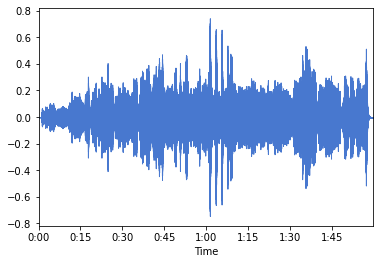

In [18]:
#Loading the Audio
filename = librosa.example('nutcracker')
y, sr = librosa.load(filename)

#Beat Tracker
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)
print('Estimated tempo: {:.2f} beats per minute'.format(tempo))

#Converting Frames to Timestamps
beat_times = librosa.frames_to_time(beat_frames, sr=sr)

#waveform
librosa.display.waveplot(y, sr)

## MER Powered Spectrogram
> Illustrates the different frequences (Hz) and volumes (dB) throughout the song using the mel scale

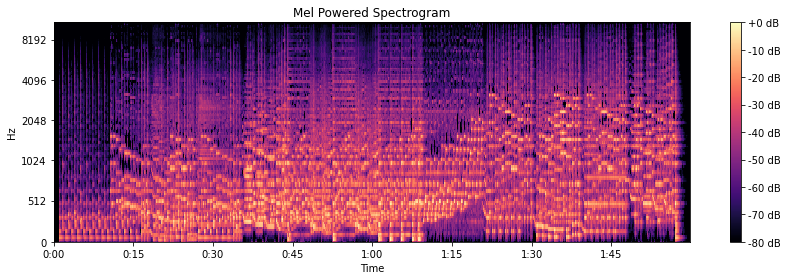

In [4]:
S = librosa.feature.melspectrogram(y, sr = sr, n_mels = 128)

#Convert to log_scale to adjust skew
log_S = librosa.power_to_db(S, ref = np.max)

#Making a new figure
plt.figure(figsize=(12,4))

#display spectrogram on a mel scale (A scale of pitches in Hz and dB that are separated according the listenability)
librosa.display.specshow(log_S, sr = sr, x_axis = 'time', y_axis = 'mel')

plt.title('Mel Powered Spectrogram')
plt.colorbar(format = '%+02.0f dB')
plt.tight_layout()

## Harmonic-Percussive Source Separation
> Separates the different elements of the song such as its harmony, motor, and percussion

In [5]:
#Separate song into harmonic and percussive elements
y_harmonic, y_percussive = librosa.effects.hpss(y)

In [9]:
#Play the whole audio
Audio(data = y, rate = sr)

In [10]:
#Play the harmonic elements of the audio
Audio(data = y_harmonic, rate = sr)

In [12]:
#Play the percussive elements of the audio
Audio(data = y_percussive, rate = sr)

In [26]:
#Computing the short time fourier transformation for y (This is in order to get intesities for each element)
D = librosa.stft(y)

#Decompose the Fourier Transformation into its harmonic and percussive elements
D_harmonic, D_percussive = librosa.decompose.hpss(D)

#Computing Global-Reference Power
rp = np.max(np.abs(D))

<Figure size 1440x720 with 0 Axes>

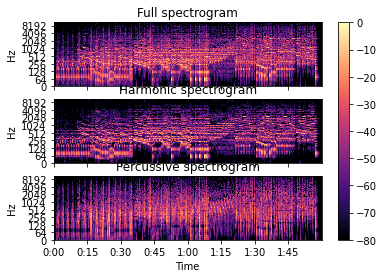

In [34]:
plt.figure(figsize=(20,10))


#Original Spectrogram
fig, ax = plt.subplots(nrows=3, sharex=True, sharey=True)
img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(D), ref=rp),y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Full spectrogram')
ax[0].label_outer()


#Plot harmonic and percussive Spectrograms 
librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_harmonic), ref=rp),y_axis='log', x_axis='time', ax=ax[1])
ax[1].set(title='Harmonic spectrogram')
ax[1].label_outer()

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_percussive), ref=rp),y_axis='log', x_axis='time', ax=ax[2])
ax[2].set(title='Percussive spectrogram')
fig.colorbar(img, ax=ax)

## Chromotogram
> Creates a graph that analyzes the different pitches (C, D, E, F, G, A, B) and their energy in the song

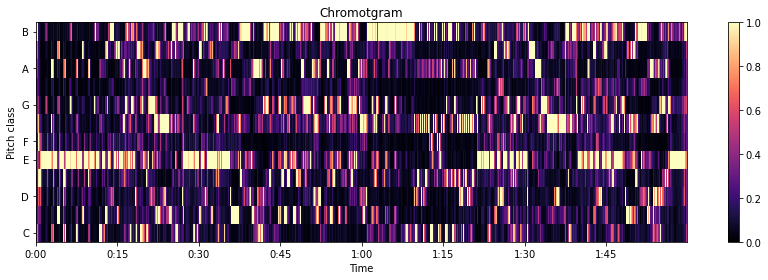

In [13]:
#Using strictly the harmony to get the different pitches
C = librosa.feature.chroma_cqt(y = y_harmonic, sr = sr)

#Making a New Figure
plt.figure(figsize = (12,4))

#Creating the Chromotgram: Shows the energy of each pitch class - C as opposed to C1, C2,... - throughout the song
librosa.display.specshow(C, sr = sr, x_axis = 'time', y_axis = 'chroma', vmin = 0, vmax = 1)

plt.title('Chromotgram')
plt.colorbar()

plt.tight_layout()

## Vocal Separation
> Here we will use a different example to explore the vocal separation techniques of librosa

In [38]:
y2, sr2 = librosa.load(librosa.ex('fishin'), duration=120)


# Compute the spectrogram magnitude and phase using the Short time Fourier Transformation
S_full, phase = librosa.magphase(librosa.stft(y2))

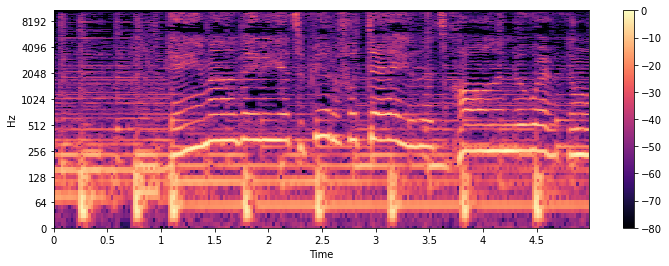

In [42]:
#Making a new plot
plt.figure(figsize = (12,4))

#Plotting a 5 second splice of the spectrum
idx = slice(*librosa.time_to_frames([10, 15], sr=sr2))
img = librosa.display.specshow(librosa.amplitude_to_db(S_full[:, idx], ref=np.max), y_axis='log', x_axis='time', sr=sr2)
plt.colorbar(img)